Exampel from [addshore](https://twitter.com/addshore) blogpost ["Wikidata user and project talk page connection graph"](https://addshore.com/2021/12/wikidata-user-and-project-talk-page-connections/)

In [2]:
#!pip install jaal pandas networkx matplotlib snap-stanford
!pip install snap-stanford
!pip install networkx

# Hide errors due to unknown chars!
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import re
import json
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from collections import Counter

You should consider upgrading via the '/Library/Frameworks/Python.framework/Versions/3.9/bin/python3.9 -m pip install --upgrade pip' command.
You should consider upgrading via the '/Library/Frameworks/Python.framework/Versions/3.9/bin/python3.9 -m pip install --upgrade pip' command.


In [3]:
# Quarry query for user talk page relations

# User only relations t1 and t2 columns
# https://quarry.wmcloud.org/query/60589
# https://quarry.wmcloud.org/run/600192/output/0/csv

# User and project relations, t1, t1ns, t2, t2ns
# https://quarry.wmcloud.org/query/60592
# https://quarry.wmcloud.org/run/600233/output/0/csv

CSV_URL = 'https://quarry.wmcloud.org/run/600233/output/0/csv'

In [4]:
# Load the data
df = pd.read_csv(CSV_URL)
print(df)

                          t1  t1ns              t2  t2ns
0       !!Fabio_de_Mello.S!!     3  Liuxinyu970226     3
1          !!a1_le_différent     3  Liuxinyu970226     3
2                !!bbrules!!     3  Liuxinyu970226     3
3           !!mmmmmmmmmmmm!!     3  Liuxinyu970226     3
4                      !!zaq     3  Liuxinyu970226     3
...                      ...   ...             ...   ...
109699                   ＫｏＺ     3  Liuxinyu970226     3
109700           Ｏ1Ｌ1Ｄ1M1A1N     3  Liuxinyu970226     3
109701                ＲＪＡＮＫＡ     3          RJANKA     3
109702                  𐰇𐱅𐰚𐰤     3    Andreasmperu     3
109703                  𐰇𐱅𐰚𐰤     3        Sarvathi     3

[109704 rows x 4 columns]


In [5]:
# Filter & sort data
# - Remove IPs
# - Find the most linked nodes
# - Filter out some of the cruft
ipv4 = r"\d+\.\d+\.\d+\.\d+"
ipv6 = r"(([0-9a-fA-F]{1,4}:){7,7}[0-9a-fA-F]{1,4}|([0-9a-fA-F]{1,4}:){1,7}:|([0-9a-fA-F]{1,4}:){1,6}:[0-9a-fA-F]{1,4}|([0-9a-fA-F]{1,4}:){1,5}(:[0-9a-fA-F]{1,4}){1,2}|([0-9a-fA-F]{1,4}:){1,4}(:[0-9a-fA-F]{1,4}){1,3}|([0-9a-fA-F]{1,4}:){1,3}(:[0-9a-fA-F]{1,4}){1,4}|([0-9a-fA-F]{1,4}:){1,2}(:[0-9a-fA-F]{1,4}){1,5}|[0-9a-fA-F]{1,4}:((:[0-9a-fA-F]{1,4}){1,6})|:((:[0-9a-fA-F]{1,4}){1,7}|:)|fe80:(:[0-9a-fA-F]{0,4}){0,4}%[0-9a-zA-Z]{1,}|::(ffff(:0{1,4}){0,1}:){0,1}((25[0-5]|(2[0-4]|1{0,1}[0-9]){0,1}[0-9])\.){3,3}(25[0-5]|(2[0-4]|1{0,1}[0-9]){0,1}[0-9])|([0-9a-fA-F]{1,4}:){1,4}:((25[0-5]|(2[0-4]|1{0,1}[0-9]){0,1}[0-9])\.){3,3}(25[0-5]|(2[0-4]|1{0,1}[0-9]){0,1}[0-9]))"

# Remove IPs
def hasip(row):
    # true to keep, if no IP matches
    return re.match(ipv4, row["t1"]) is None and re.match(ipv4, row["t2"]) is None and re.match(ipv6, row["t1"]) is None and re.match(ipv6, row["t2"]) is None
df_filtered = df[df.apply(hasip, axis=1)]

# Count value occourance & give every value an int
values = list(df_filtered['t1'].values) + list(df_filtered['t2'].values)
counted_values = Counter(values)


In [13]:
#unique_values_list = list(counted_values.keys())
#val_to_int = {}
#for i in range(0, len(unique_values_list)) :
#    val_to_int[unique_values_list[i]] = i
    
#print(counted_values)

                   t1  t1ns                 t2  t2ns
48         &beer&love     3           Blackcat     3
52         &beer&love     3            CennoxX     3
55         &beer&love     3           Davidpar     3
58         &beer&love     3  Dipsacus_fullonum     3
59         &beer&love     3              E4024     3
...               ...   ...                ...   ...
108453  আফতাবুজ্জামান     3      MisterSynergy     3
108457  আফতাবুজ্জামান     3           Sondrion     3
108459  আফতাবুজ্জামান     3          Titodutta     3
108460  আফতাবুজ্জামান     3  WikiProject_India     5
109598           분당선M     3          *Youngjin     3

[15985 rows x 4 columns]


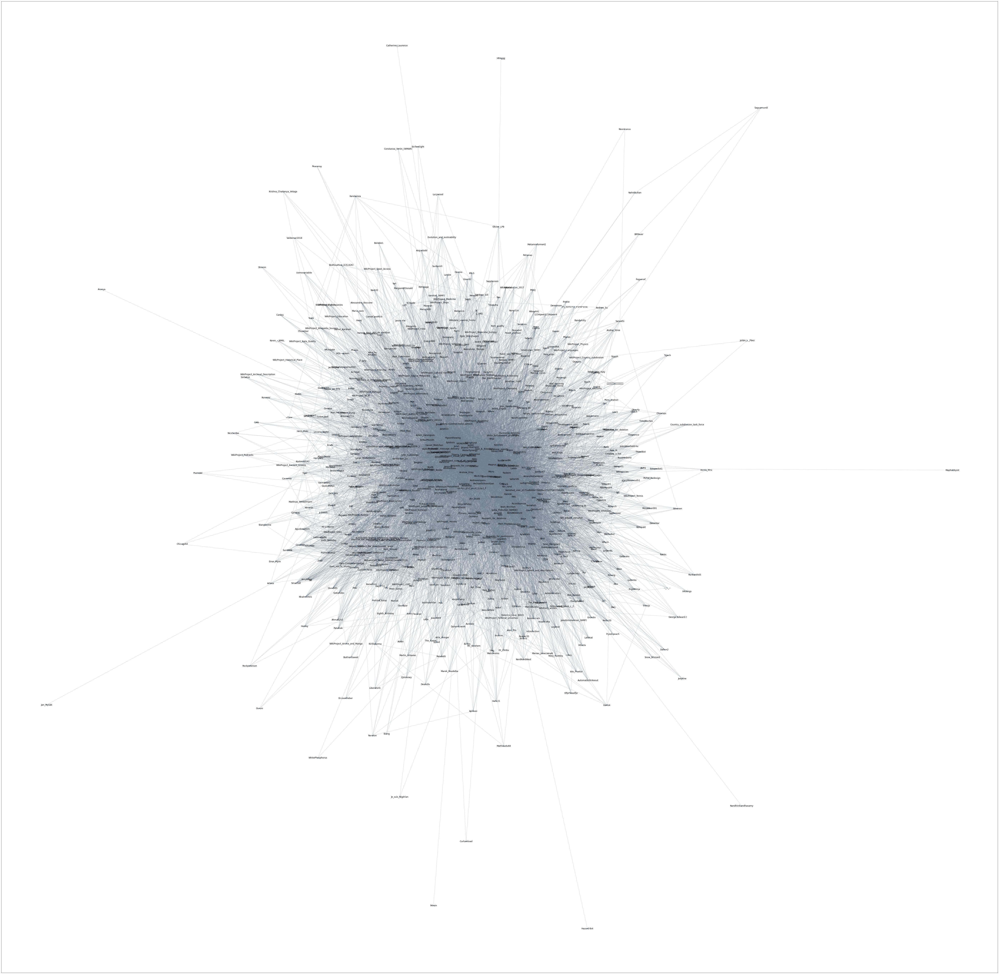

In [10]:
one_must_have = 200
both_must_have = 25
one_must_not_have = 999999999
def hasEnoughRefs(row):
    t1Count = counted_values[row["t1"]]# Count of times t1 is involved in a link
    t2Count = counted_values[row["t2"]]# Count of times t2 is involved in a link
    # true to keep
    return ( t1Count >= one_must_have or t2Count >= one_must_have ) and ( t1Count >= both_must_have and t2Count >= both_must_have ) and ( t1Count <= one_must_not_have or t2Count <= one_must_not_have )
df_1 = df_filtered[df_filtered.apply(hasEnoughRefs, axis=1)]

print(df_1)

G = nx.from_pandas_edgelist(df_1,source='t1',target='t2')
fig, ax = plt.subplots(1, 1, figsize=(100, 100));
# https://networkx.org/documentation/networkx-1.7/reference/generated/networkx.drawing.nx_pylab.draw_networkx.html
nx.draw_networkx(G, ax=ax,with_labels=True, node_size=5,style="dashed",width=0.5,edge_color='slategrey')

                     t1  t1ns               t2  t2ns
77           &beer&love     3  Jon_Harald_Søby     3
78           &beer&love     3            Jura1     3
99           &beer&love     3    Pigsonthewing     3
112          &beer&love     3         VIGNERON     3
176           *Youngjin     3  Jon_Harald_Søby     3
...                 ...   ...              ...   ...
108137    لينيوس_العربي     3       Tobias1984     3
108402      संजीव_कुमार     3     Andreasmperu     3
108428  हिंदुस्थान_वासी     3   Liuxinyu970226     3
109558             관인생략     3       Tobias1984     3
109674              콩가루     3       Tobias1984     3

[3326 rows x 4 columns]


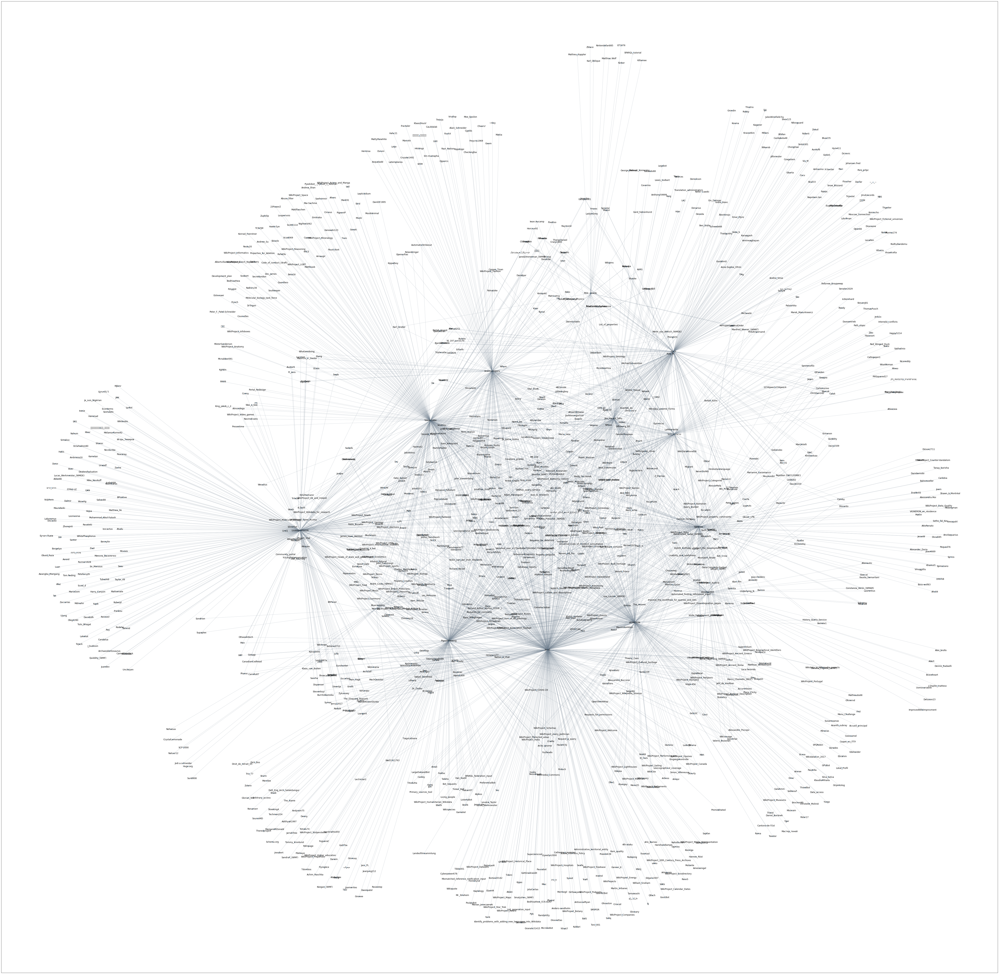

In [11]:
one_must_have = 900
both_must_have = 10
one_must_not_have = 999999999
def hasEnoughRefs(row):
    t1Count = counted_values[row["t1"]]# Count of times t1 is involved in a link
    t2Count = counted_values[row["t2"]]# Count of times t2 is involved in a link
    # true to keep
    return ( t1Count >= one_must_have or t2Count >= one_must_have ) and ( t1Count >= both_must_have and t2Count >= both_must_have ) and ( t1Count <= one_must_not_have or t2Count <= one_must_not_have )
df_2 = df_filtered[df_filtered.apply(hasEnoughRefs, axis=1)]

print(df_2)

G = nx.from_pandas_edgelist(df_2,source='t1',target='t2')
fig, ax = plt.subplots(1, 1, figsize=(100, 100));
# https://networkx.org/documentation/networkx-1.7/reference/generated/networkx.drawing.nx_pylab.draw_networkx.html
nx.draw_networkx(G, ax=ax,with_labels=True, node_size=5,style="dashed",width=0.5,edge_color='slategrey')

                t1  t1ns               t2  t2ns
77      &beer&love     3  Jon_Harald_Søby     3
176      *Youngjin     3  Jon_Harald_Søby     3
203      *Youngjin     3       Tobias1984     3
273          -Zest     3   Liuxinyu970226     3
328          -revi     3         Epìdosis     3
...            ...   ...              ...   ...
109364         胡葡萄     3   Liuxinyu970226     3
109443       邻家的王子     3   Liuxinyu970226     3
109558        관인생략     3       Tobias1984     3
109562         궁대균     3   Liuxinyu970226     3
109674         콩가루     3       Tobias1984     3

[1810 rows x 4 columns]


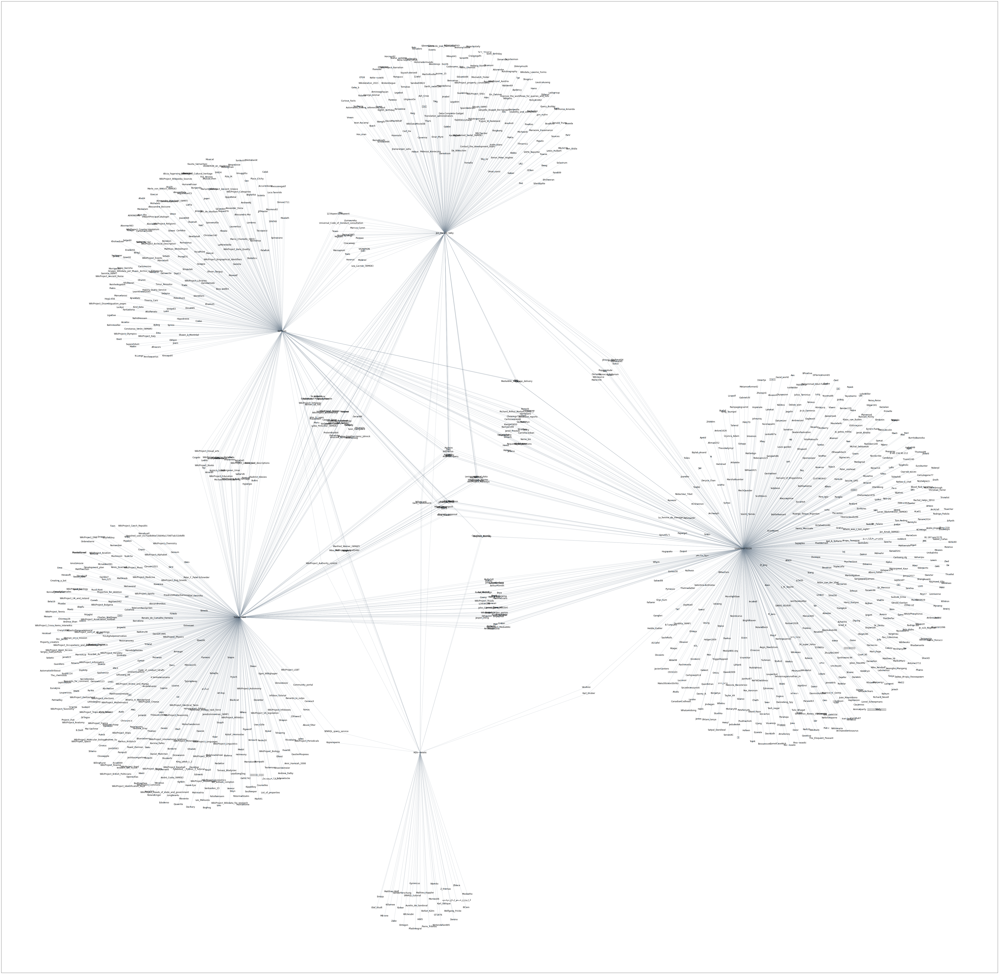

In [12]:
one_must_have = 1500
both_must_have = 5
one_must_not_have = 999999999
def hasEnoughRefs(row):
    t1Count = counted_values[row["t1"]]# Count of times t1 is involved in a link
    t2Count = counted_values[row["t2"]]# Count of times t2 is involved in a link
    # true to keep
    return ( t1Count >= one_must_have or t2Count >= one_must_have ) and ( t1Count >= both_must_have and t2Count >= both_must_have ) and ( t1Count <= one_must_not_have or t2Count <= one_must_not_have )
df_2 = df_filtered[df_filtered.apply(hasEnoughRefs, axis=1)]

print(df_2)

G = nx.from_pandas_edgelist(df_2,source='t1',target='t2')
fig, ax = plt.subplots(1, 1, figsize=(100, 100));
# https://networkx.org/documentation/networkx-1.7/reference/generated/networkx.drawing.nx_pylab.draw_networkx.html
nx.draw_networkx(G, ax=ax,with_labels=True, node_size=5,style="dashed",width=0.5,edge_color='slategrey')